In [ ]:
!unzip /content/archive_5.zip -d /content/images

In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from tqdm import tqdm
import torchvision.datasets as datasets
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import torchvision.utils as vutils
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torch.utils.data import Subset
import numpy as np

In [25]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
LEARNING_RATE = 2e-4  # could also use two lrs, one for gen and one for disc
BATCH_SIZE = 128
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 50
FEATURES_DISC = 64
FEATURES_GEN = 64

In [16]:
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = datasets.ImageFolder('/content/images', transform=transform)
dataloader = DataLoader(dataset=dataset, batch_size=BATCH_SIZE, shuffle=True)

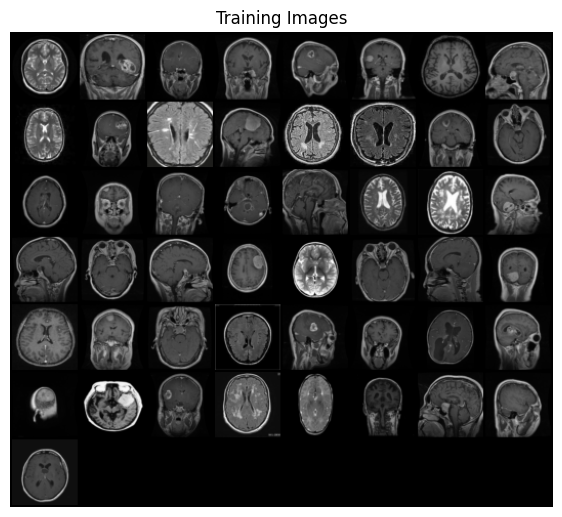

In [17]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(7,7))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:49], padding=2, normalize=True).cpu(),(1,2,0)))

In [18]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            self._block(z_dim, features_g * 16, 4, 1, 0),
            self._block(features_g * 16, features_g * 8, 4, 2, 1),
            self._block(features_g * 8, features_g * 4, 4, 2, 1),
            self._block(features_g * 4, features_g * 2, 4, 2, 1),
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            nn.Tanh()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):
        return self.net(x)

In [19]:
class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            nn.Sigmoid()
        )

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False
            ),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

    def forward(self, x):
        return self.disc(x)

In [20]:
def initialize_weights(model):
    classname = model.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(model.weight.data, 1.0, 0.02)
        nn.init.constant_(model.bias.data, 0)

In [21]:
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)

initialize_weights(gen)
initialize_weights(disc)

In [22]:
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

In [23]:
def show_tensor_images(image_tensor, num_images=32, size=(1, 64, 64)):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=4)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

Epoch [0/50] Batch 0/55                   Loss D: 0.2984, loss G: 1.4731


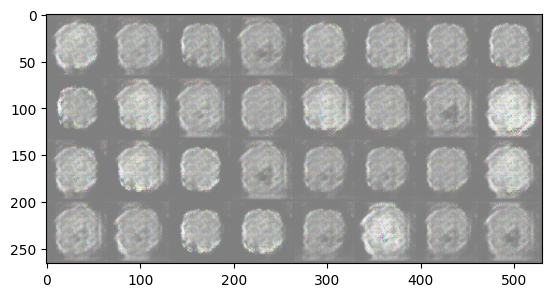

Epoch [0/50] Batch 50/55                   Loss D: 0.5475, loss G: 2.9121


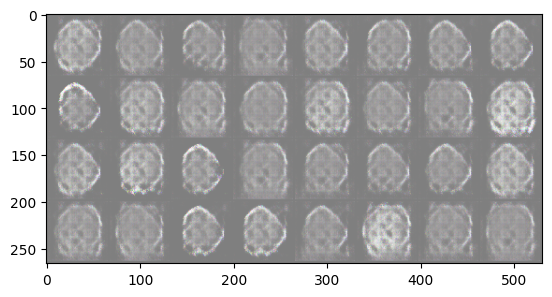

Epoch [1/50] Batch 0/55                   Loss D: 0.3053, loss G: 2.9757


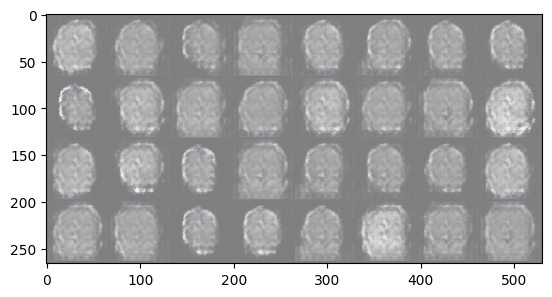

Epoch [1/50] Batch 50/55                   Loss D: 0.2081, loss G: 2.0529


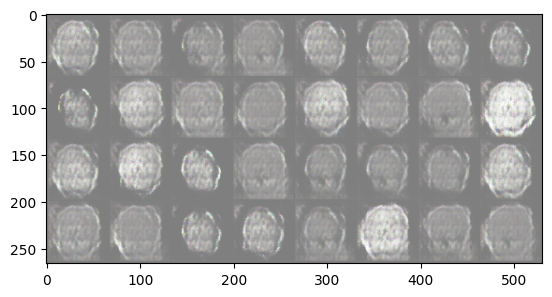

Epoch [2/50] Batch 0/55                   Loss D: 0.2204, loss G: 2.6555


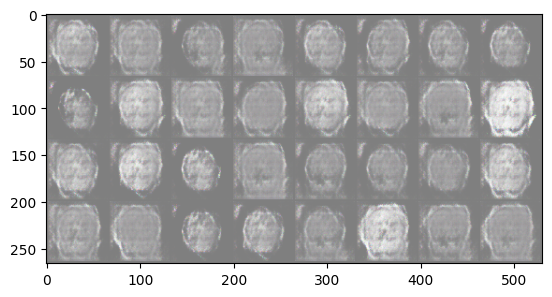

Epoch [2/50] Batch 50/55                   Loss D: 0.3948, loss G: 2.2719


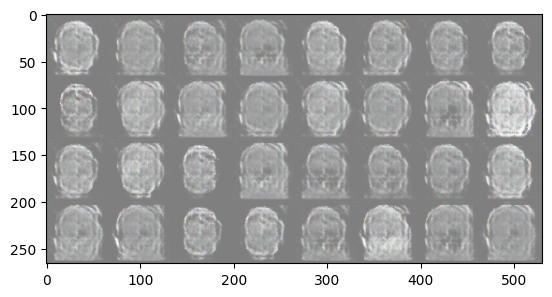

Epoch [3/50] Batch 0/55                   Loss D: 0.3520, loss G: 2.9730


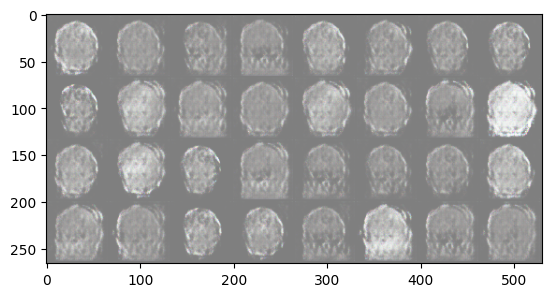

Epoch [3/50] Batch 50/55                   Loss D: 0.2630, loss G: 3.9152


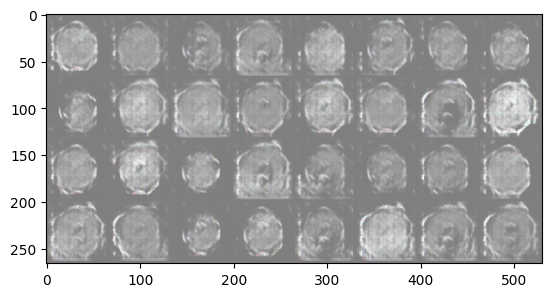

Epoch [4/50] Batch 0/55                   Loss D: 0.4230, loss G: 3.1512


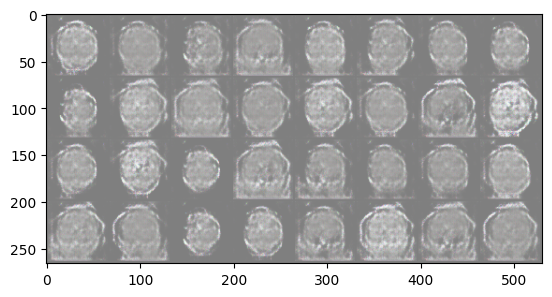

Epoch [4/50] Batch 50/55                   Loss D: 0.3762, loss G: 2.0782


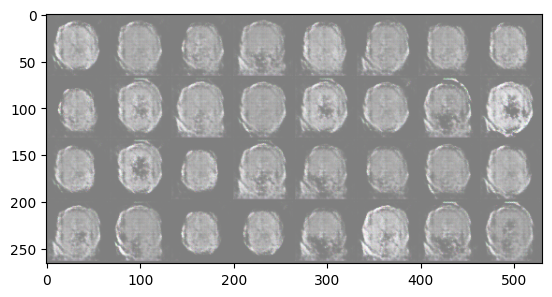

Epoch [5/50] Batch 0/55                   Loss D: 0.2729, loss G: 2.4348


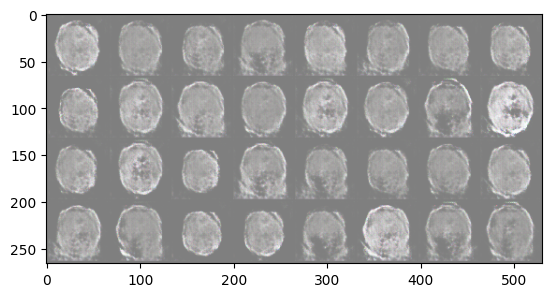

Epoch [5/50] Batch 50/55                   Loss D: 0.5428, loss G: 1.7478


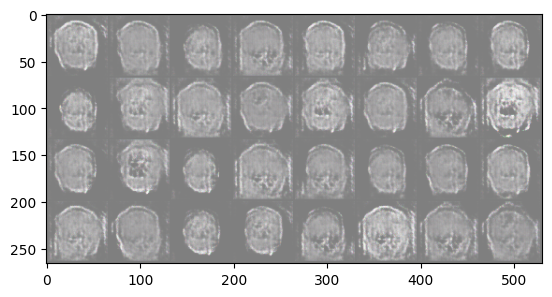

Epoch [6/50] Batch 0/55                   Loss D: 0.3312, loss G: 2.3066


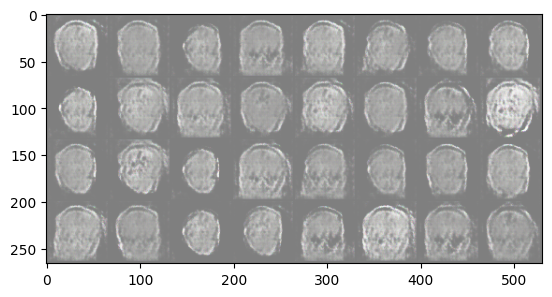

Epoch [6/50] Batch 50/55                   Loss D: 0.3222, loss G: 2.9970


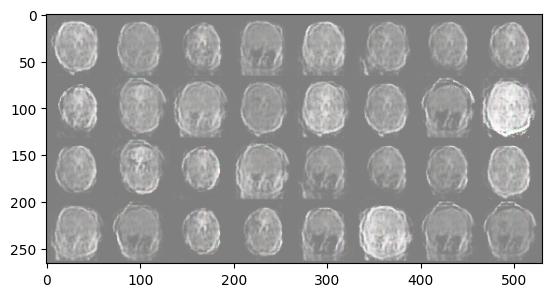

Epoch [7/50] Batch 0/55                   Loss D: 0.3576, loss G: 1.8102


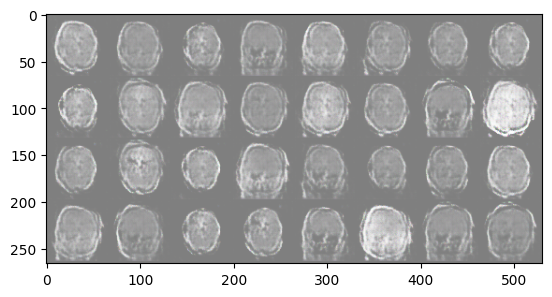

Epoch [7/50] Batch 50/55                   Loss D: 0.2667, loss G: 3.2592


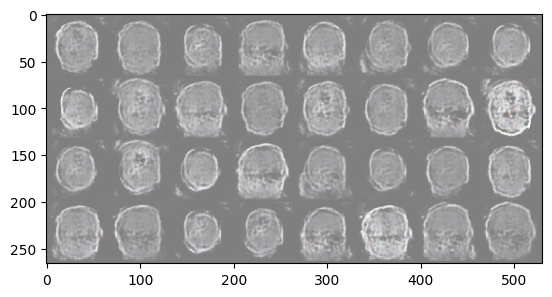

Epoch [8/50] Batch 0/55                   Loss D: 0.2649, loss G: 3.1688


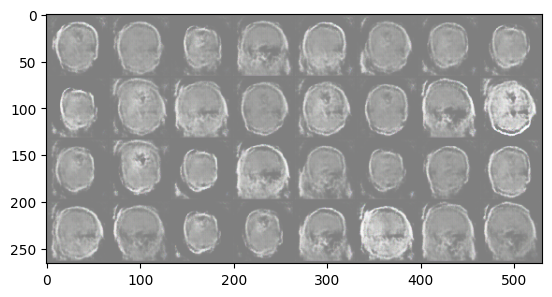

Epoch [8/50] Batch 50/55                   Loss D: 0.2763, loss G: 4.1013


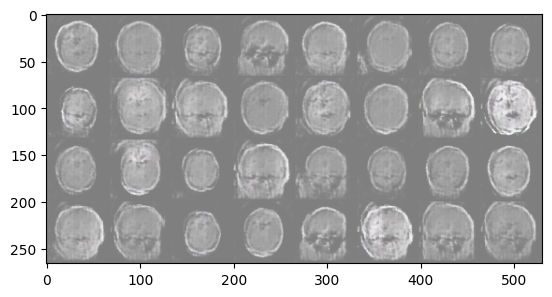

Epoch [9/50] Batch 0/55                   Loss D: 0.4599, loss G: 6.4130


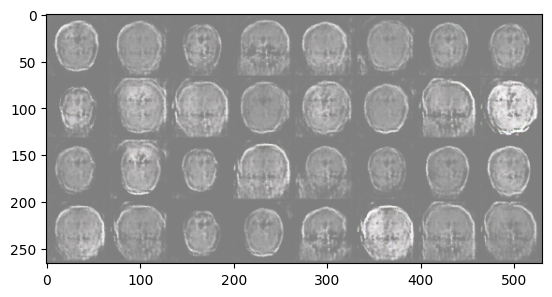

Epoch [9/50] Batch 50/55                   Loss D: 0.4270, loss G: 3.2280


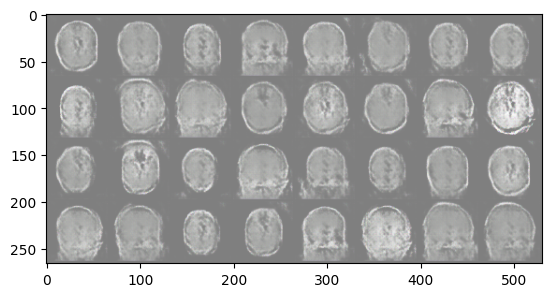

Epoch [10/50] Batch 0/55                   Loss D: 0.3481, loss G: 3.5782


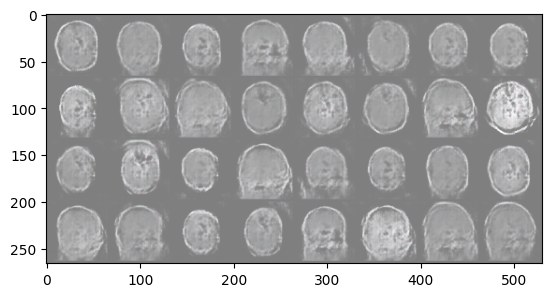

Epoch [10/50] Batch 50/55                   Loss D: 0.3402, loss G: 2.0670


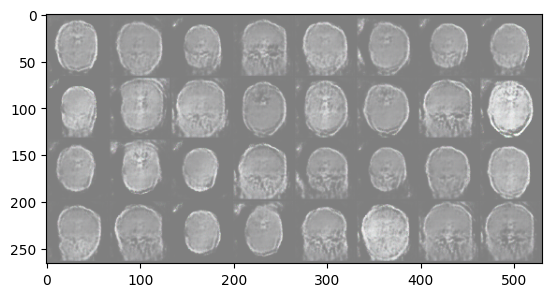

Epoch [11/50] Batch 0/55                   Loss D: 0.6398, loss G: 4.3763


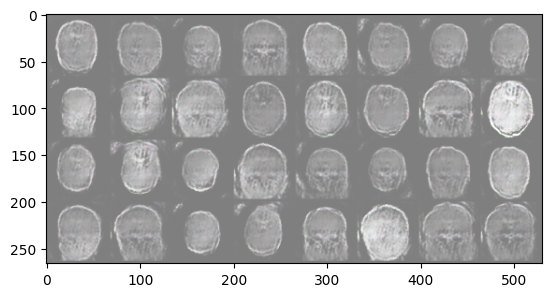

Epoch [11/50] Batch 50/55                   Loss D: 0.3621, loss G: 2.1231


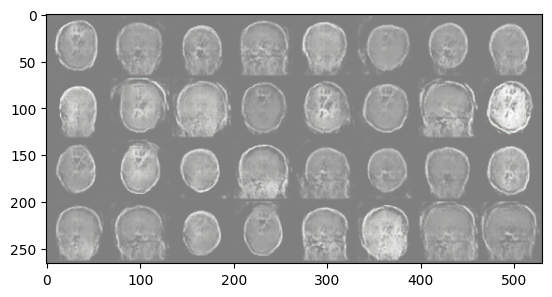

Epoch [12/50] Batch 0/55                   Loss D: 0.7624, loss G: 2.0809


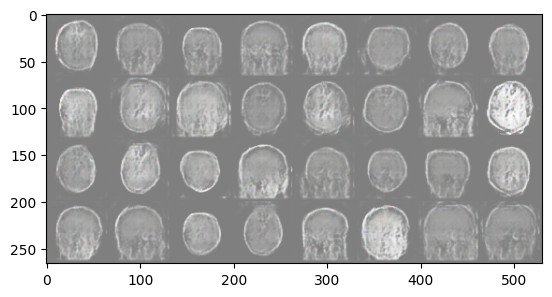

Epoch [12/50] Batch 50/55                   Loss D: 0.3988, loss G: 3.2605


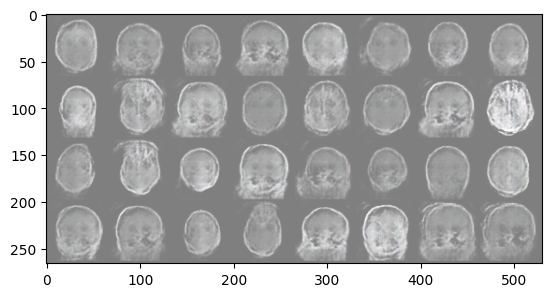

Epoch [13/50] Batch 0/55                   Loss D: 0.3605, loss G: 2.1049


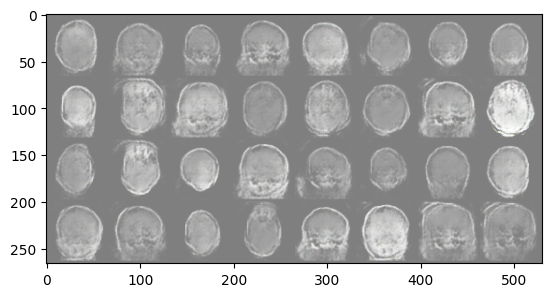

Epoch [13/50] Batch 50/55                   Loss D: 0.5628, loss G: 3.0531


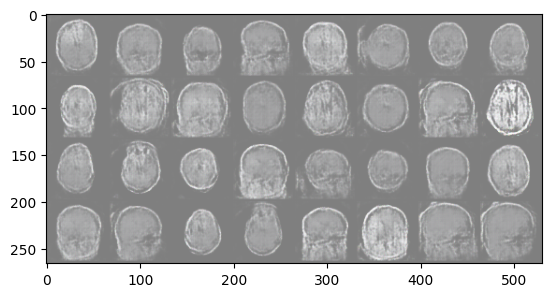

Epoch [14/50] Batch 0/55                   Loss D: 0.4690, loss G: 2.5847


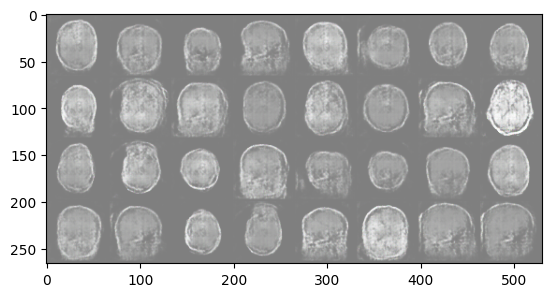

Epoch [14/50] Batch 50/55                   Loss D: 0.3821, loss G: 1.5093


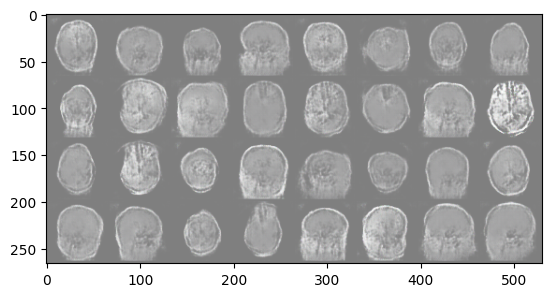

Epoch [15/50] Batch 0/55                   Loss D: 0.4110, loss G: 2.9350


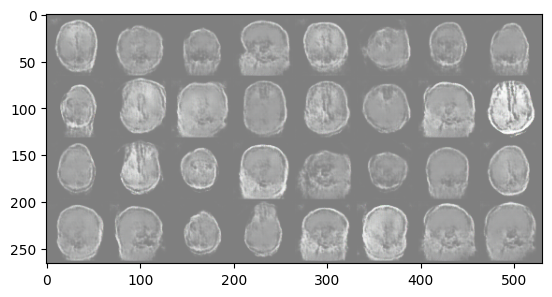

Epoch [15/50] Batch 50/55                   Loss D: 0.3929, loss G: 2.0543


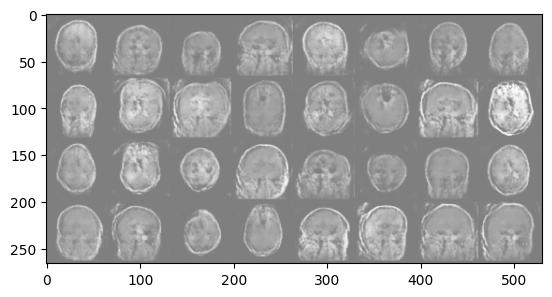

Epoch [16/50] Batch 0/55                   Loss D: 0.4646, loss G: 4.3683


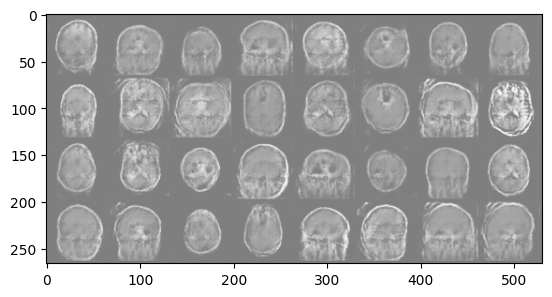

Epoch [16/50] Batch 50/55                   Loss D: 0.4449, loss G: 1.2007


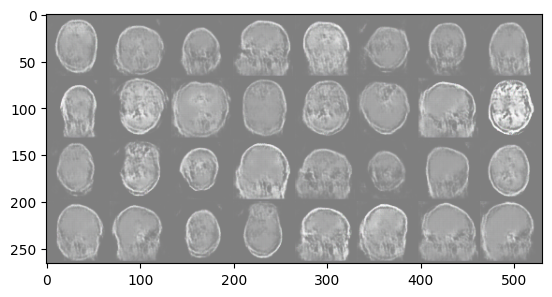

Epoch [17/50] Batch 0/55                   Loss D: 0.3623, loss G: 1.6717


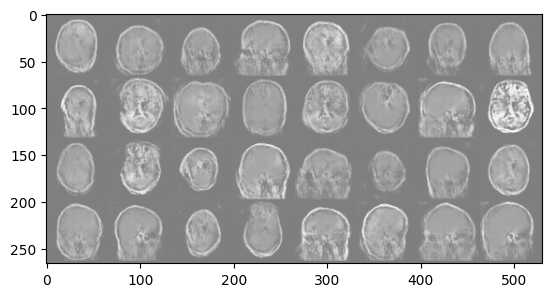

Epoch [17/50] Batch 50/55                   Loss D: 0.3241, loss G: 2.9252


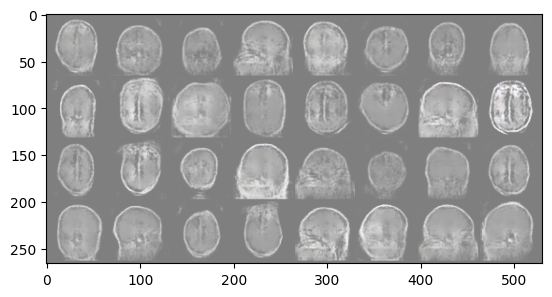

Epoch [18/50] Batch 0/55                   Loss D: 0.3805, loss G: 2.8791


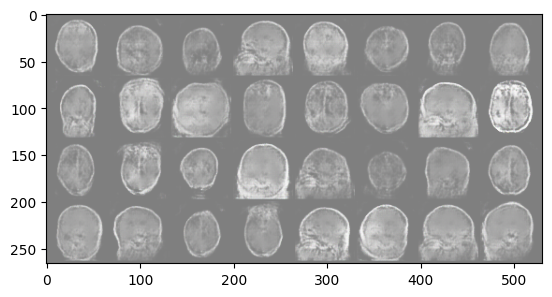

Epoch [18/50] Batch 50/55                   Loss D: 0.2612, loss G: 1.3215


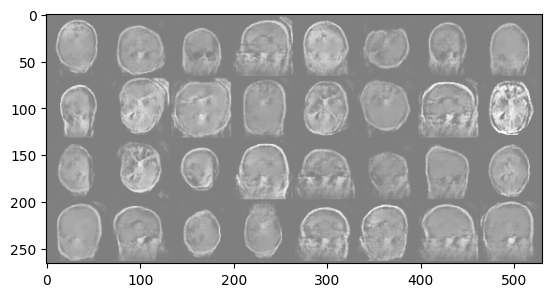

Epoch [19/50] Batch 0/55                   Loss D: 0.6866, loss G: 3.6744


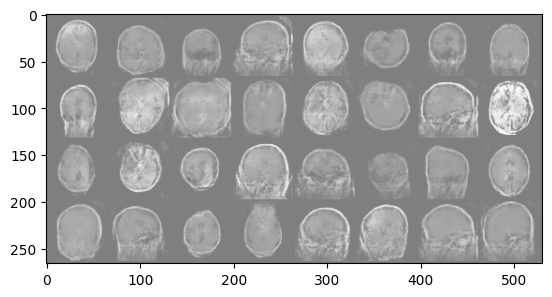

Epoch [19/50] Batch 50/55                   Loss D: 0.6089, loss G: 4.9672


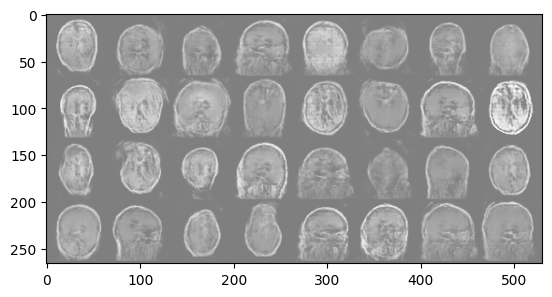

Epoch [20/50] Batch 0/55                   Loss D: 0.2508, loss G: 1.4846


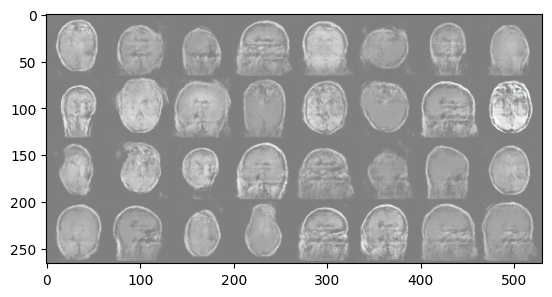

Epoch [20/50] Batch 50/55                   Loss D: 0.5315, loss G: 1.5562


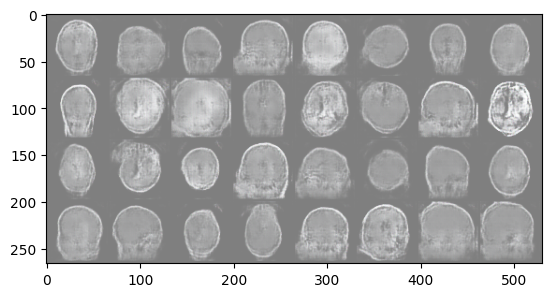

Epoch [21/50] Batch 0/55                   Loss D: 0.3870, loss G: 2.5421


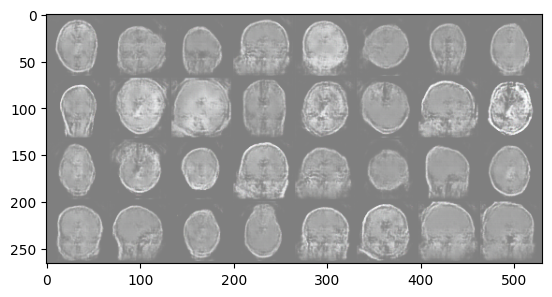

Epoch [21/50] Batch 50/55                   Loss D: 0.4025, loss G: 1.8972


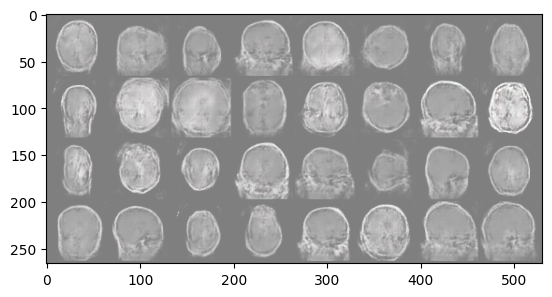

Epoch [22/50] Batch 0/55                   Loss D: 0.3396, loss G: 2.9456


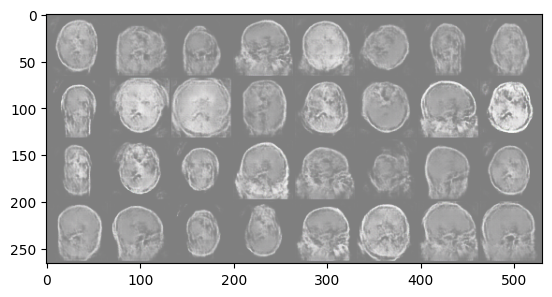

Epoch [22/50] Batch 50/55                   Loss D: 0.3380, loss G: 3.1721


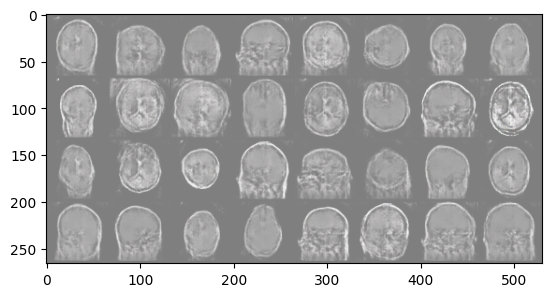

Epoch [23/50] Batch 0/55                   Loss D: 0.6342, loss G: 1.4951


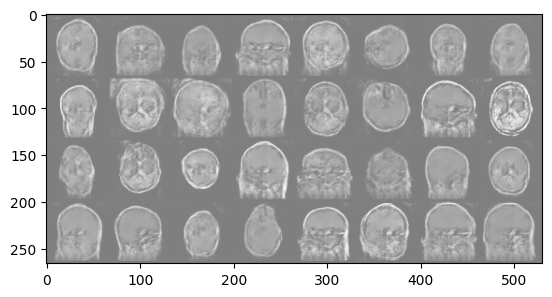

Epoch [23/50] Batch 50/55                   Loss D: 0.2246, loss G: 2.3920


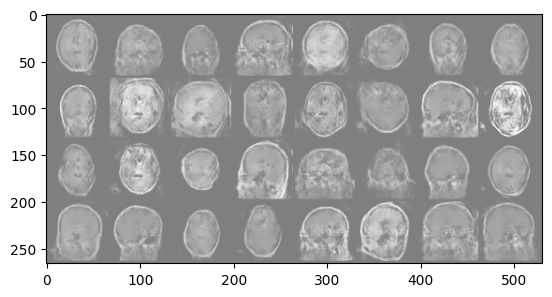

Epoch [24/50] Batch 0/55                   Loss D: 0.3714, loss G: 2.7264


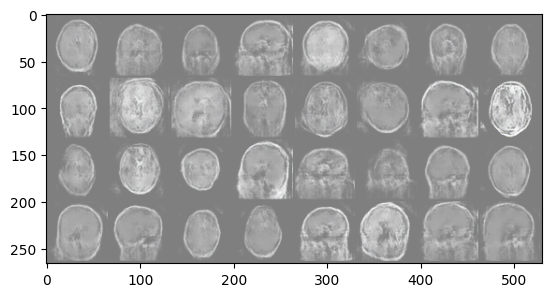

Epoch [24/50] Batch 50/55                   Loss D: 0.2577, loss G: 1.2832


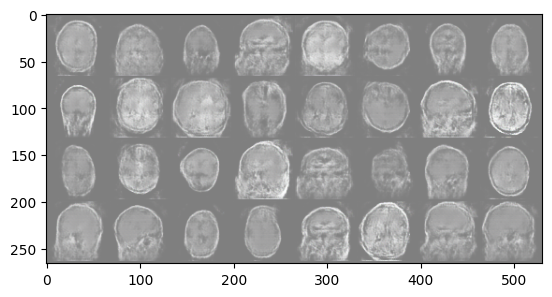

Epoch [25/50] Batch 0/55                   Loss D: 0.2795, loss G: 1.8647


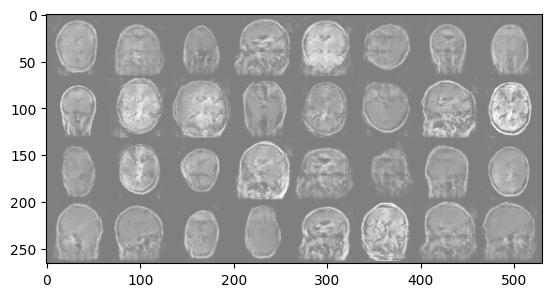

Epoch [25/50] Batch 50/55                   Loss D: 0.2677, loss G: 2.0287


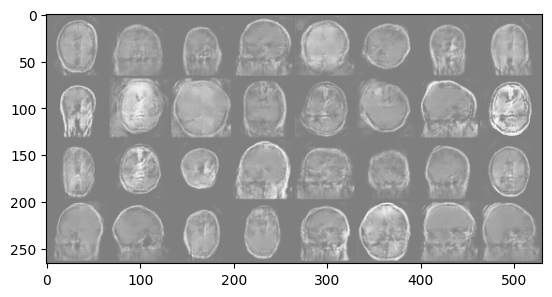

Epoch [26/50] Batch 0/55                   Loss D: 0.4382, loss G: 6.0147


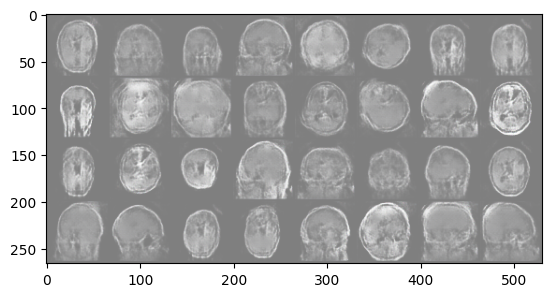

Epoch [26/50] Batch 50/55                   Loss D: 0.3669, loss G: 1.2583


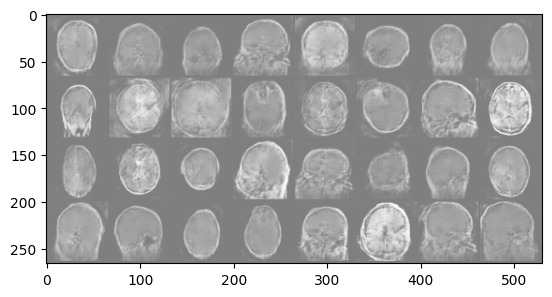

Epoch [27/50] Batch 0/55                   Loss D: 0.3377, loss G: 1.5982


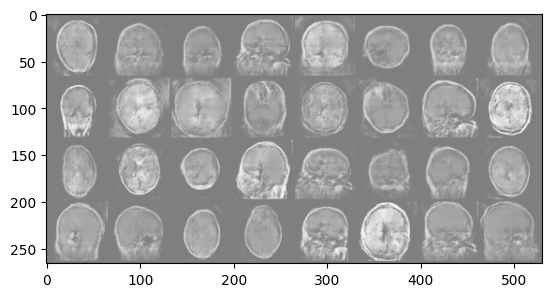

Epoch [27/50] Batch 50/55                   Loss D: 0.2978, loss G: 1.6234


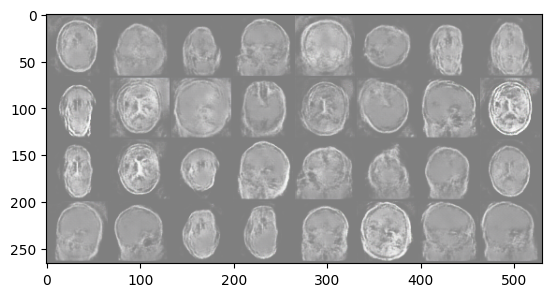

Epoch [28/50] Batch 0/55                   Loss D: 0.4255, loss G: 3.8455


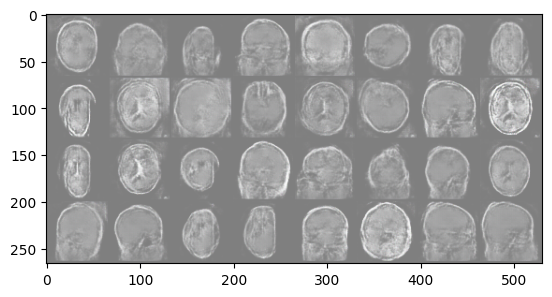

Epoch [28/50] Batch 50/55                   Loss D: 0.1950, loss G: 2.8684


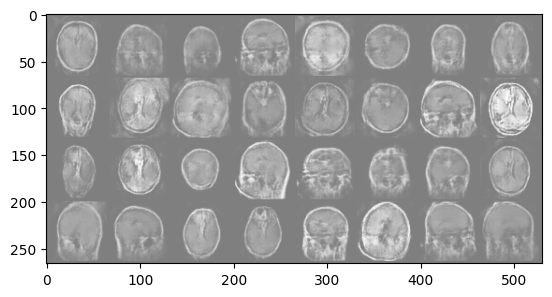

Epoch [29/50] Batch 0/55                   Loss D: 0.5776, loss G: 0.7727


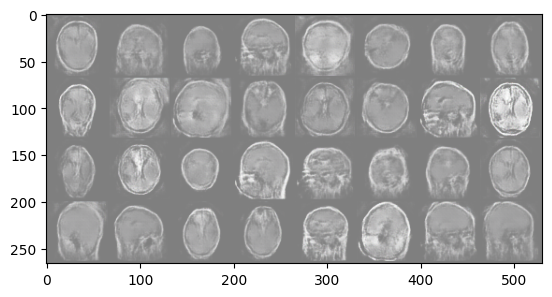

Epoch [29/50] Batch 50/55                   Loss D: 0.5078, loss G: 1.2436


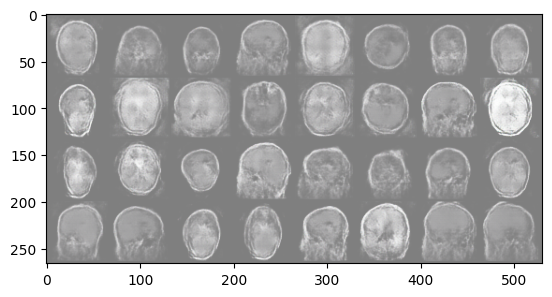

Epoch [30/50] Batch 0/55                   Loss D: 0.1986, loss G: 2.7938


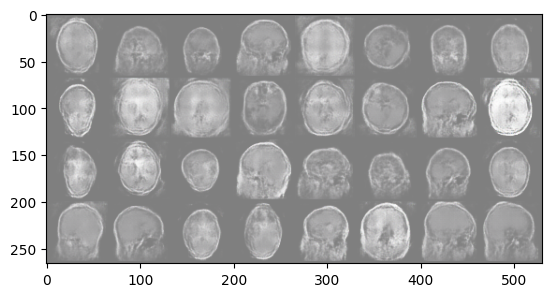

Epoch [30/50] Batch 50/55                   Loss D: 0.2707, loss G: 3.4800


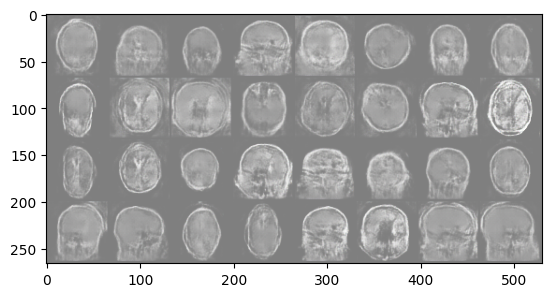

Epoch [31/50] Batch 0/55                   Loss D: 0.3283, loss G: 3.5217


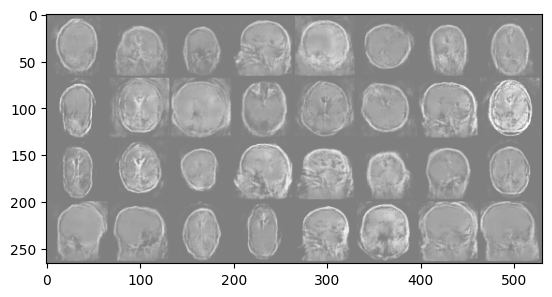

Epoch [31/50] Batch 50/55                   Loss D: 0.3332, loss G: 1.6723


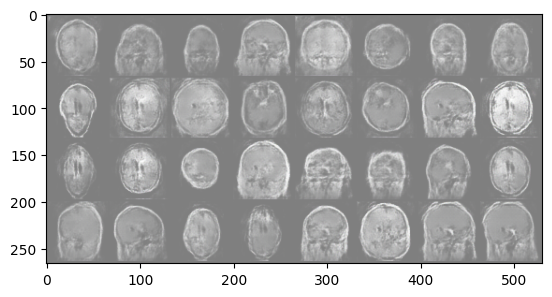

Epoch [32/50] Batch 0/55                   Loss D: 0.2561, loss G: 3.6536


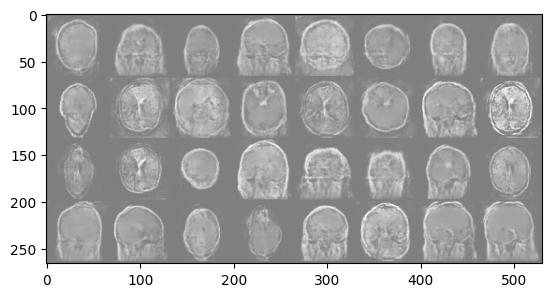

Epoch [32/50] Batch 50/55                   Loss D: 0.6516, loss G: 5.5812


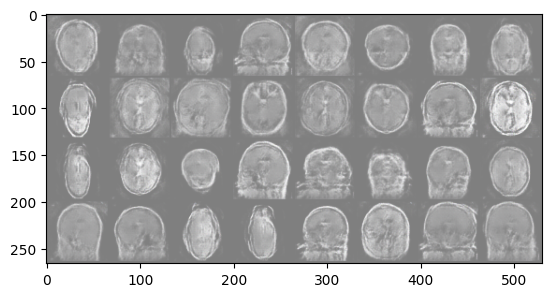

Epoch [33/50] Batch 0/55                   Loss D: 0.2474, loss G: 2.0581


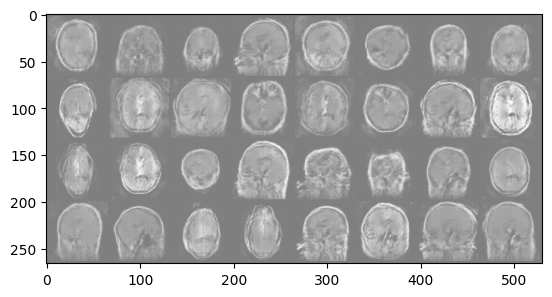

Epoch [33/50] Batch 50/55                   Loss D: 0.3718, loss G: 1.7627


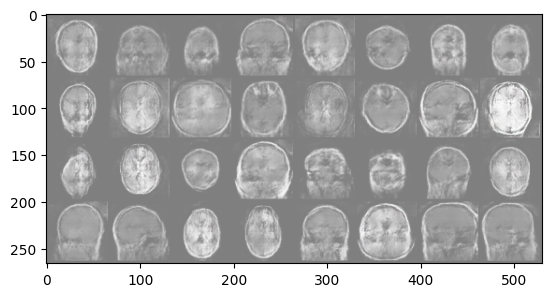

Epoch [34/50] Batch 0/55                   Loss D: 0.2357, loss G: 2.2980


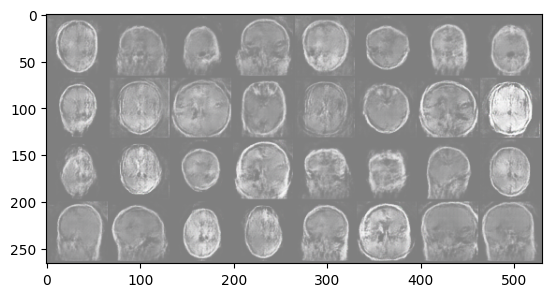

Epoch [34/50] Batch 50/55                   Loss D: 0.4553, loss G: 2.3172


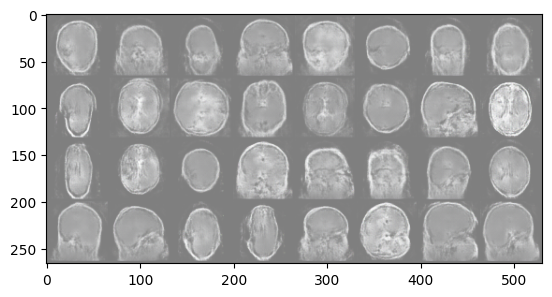

Epoch [35/50] Batch 0/55                   Loss D: 0.2556, loss G: 2.7367


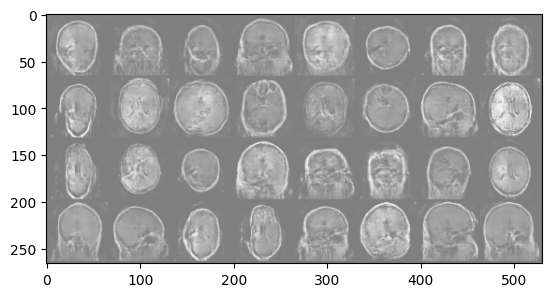

Epoch [35/50] Batch 50/55                   Loss D: 0.7054, loss G: 0.9385


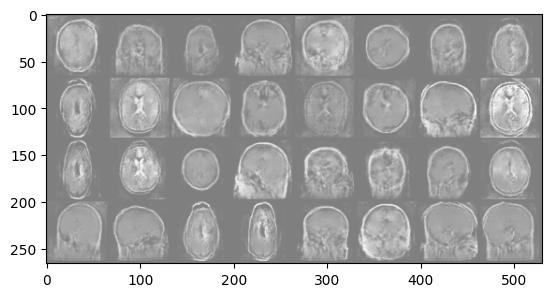

Epoch [36/50] Batch 0/55                   Loss D: 0.2651, loss G: 2.3873


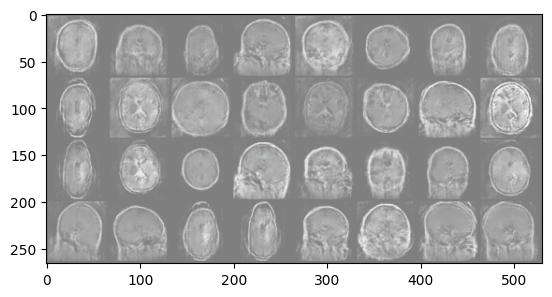

Epoch [36/50] Batch 50/55                   Loss D: 0.3357, loss G: 1.4776


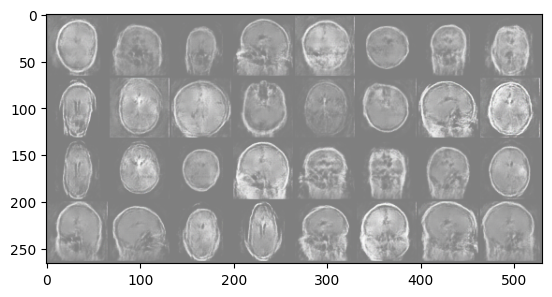

Epoch [37/50] Batch 0/55                   Loss D: 0.3699, loss G: 1.9158


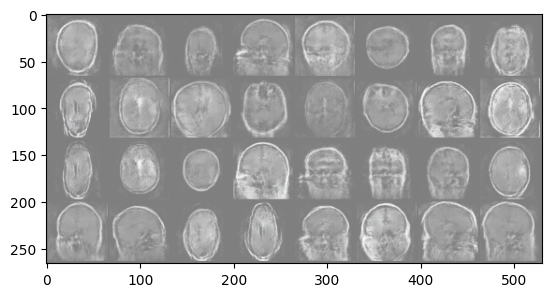

Epoch [37/50] Batch 50/55                   Loss D: 0.5014, loss G: 2.3229


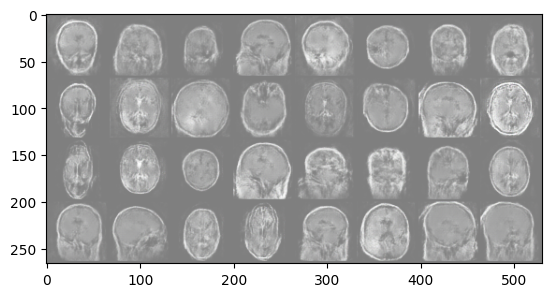

Epoch [38/50] Batch 0/55                   Loss D: 0.2459, loss G: 2.0323


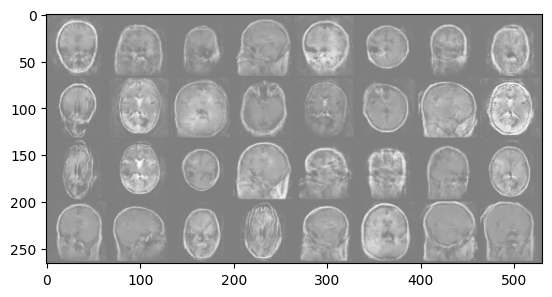

Epoch [38/50] Batch 50/55                   Loss D: 0.2870, loss G: 1.7347


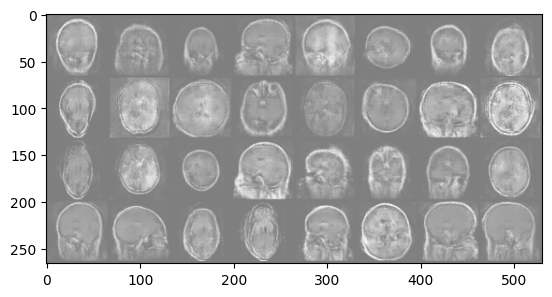

Epoch [39/50] Batch 0/55                   Loss D: 0.6958, loss G: 5.0776


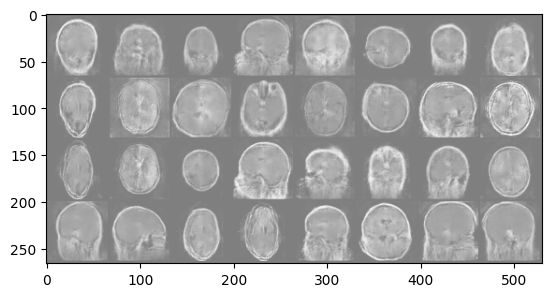

Epoch [39/50] Batch 50/55                   Loss D: 0.2575, loss G: 1.4252


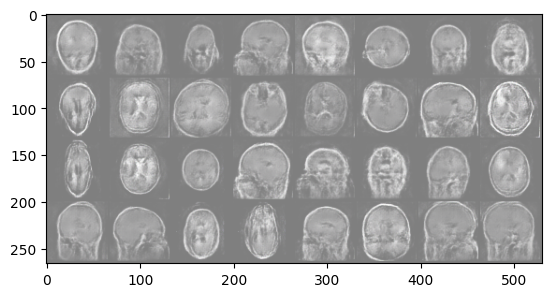

Epoch [40/50] Batch 0/55                   Loss D: 0.2268, loss G: 2.4712


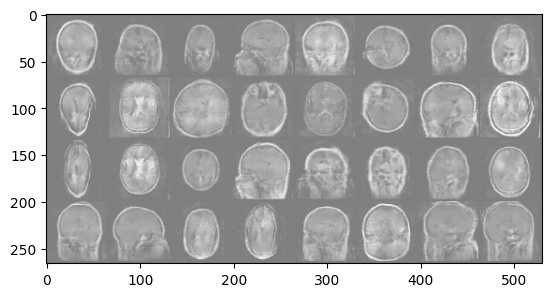

Epoch [40/50] Batch 50/55                   Loss D: 0.3087, loss G: 3.8389


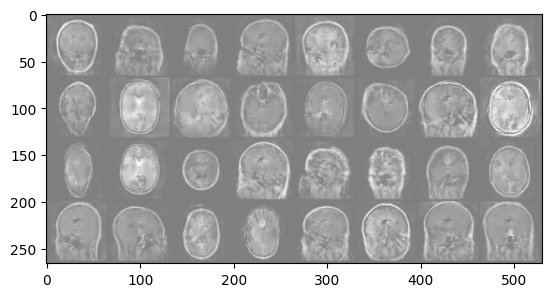

Epoch [41/50] Batch 0/55                   Loss D: 0.4287, loss G: 4.4780


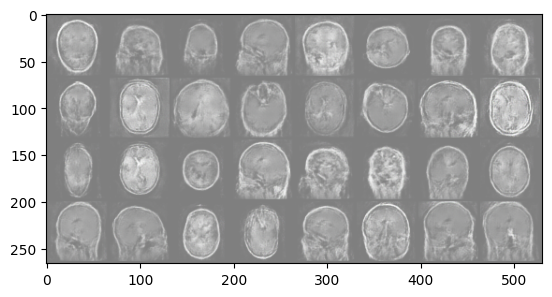

Epoch [41/50] Batch 50/55                   Loss D: 0.3020, loss G: 2.9207


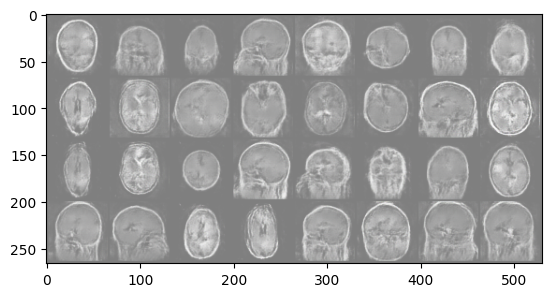

Epoch [42/50] Batch 0/55                   Loss D: 0.3634, loss G: 3.7724


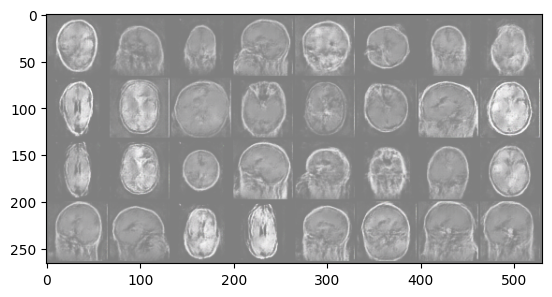

Epoch [42/50] Batch 50/55                   Loss D: 0.1619, loss G: 2.9686


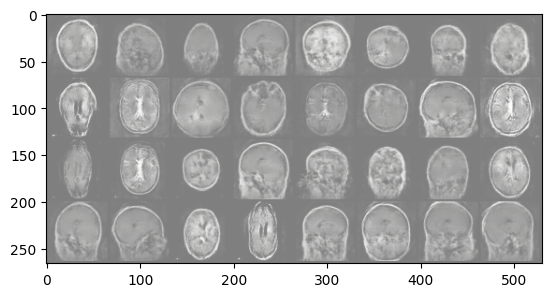

Epoch [43/50] Batch 0/55                   Loss D: 0.7241, loss G: 0.6481


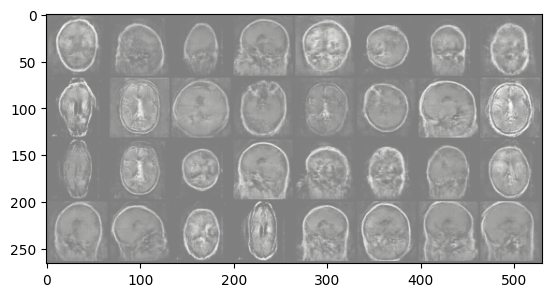

Epoch [43/50] Batch 50/55                   Loss D: 0.2232, loss G: 2.1934


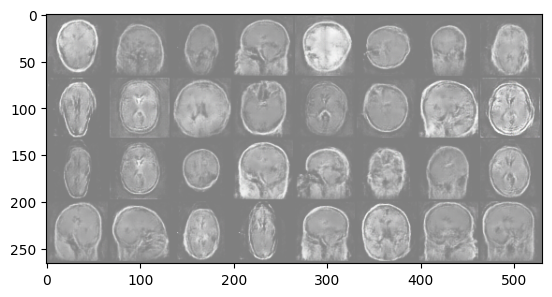

Epoch [44/50] Batch 0/55                   Loss D: 0.2021, loss G: 3.0178


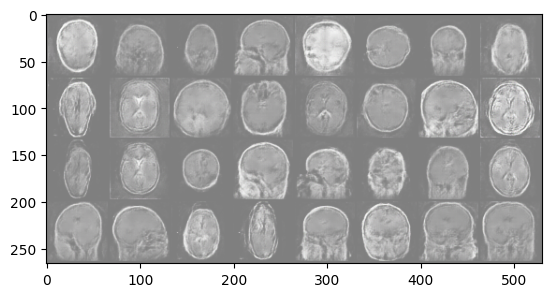

Epoch [44/50] Batch 50/55                   Loss D: 0.2438, loss G: 2.0479


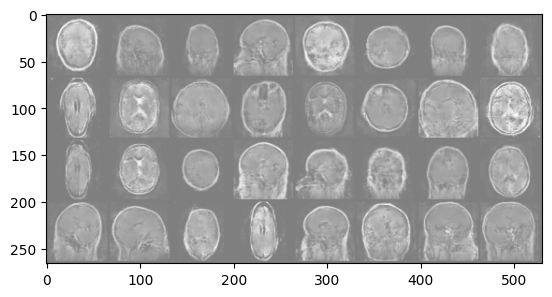

Epoch [45/50] Batch 0/55                   Loss D: 0.4308, loss G: 0.6943


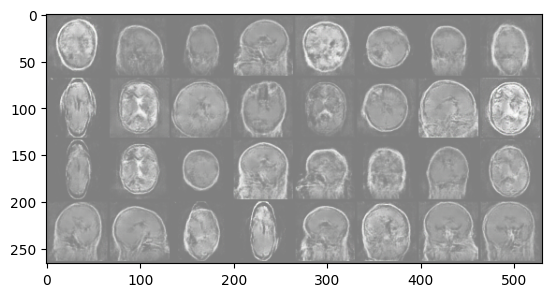

Epoch [45/50] Batch 50/55                   Loss D: 0.2061, loss G: 3.5327


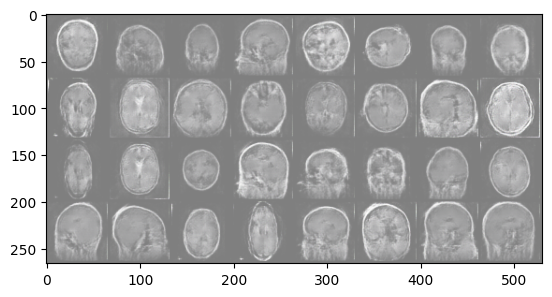

Epoch [46/50] Batch 0/55                   Loss D: 0.3092, loss G: 3.2278


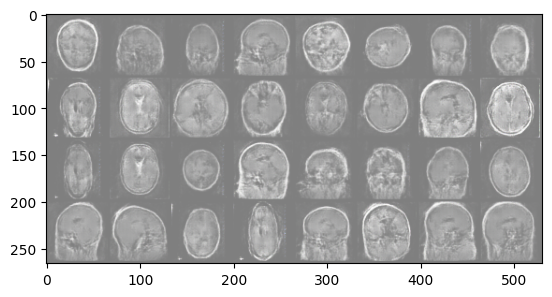

Epoch [46/50] Batch 50/55                   Loss D: 0.2561, loss G: 2.0879


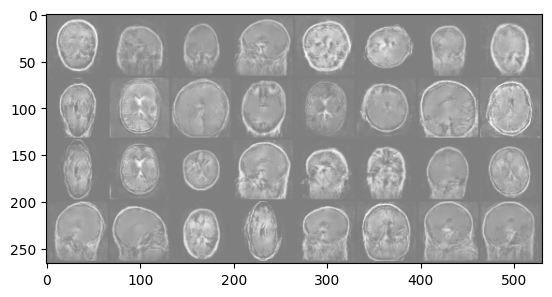

Epoch [47/50] Batch 0/55                   Loss D: 0.4621, loss G: 2.5034


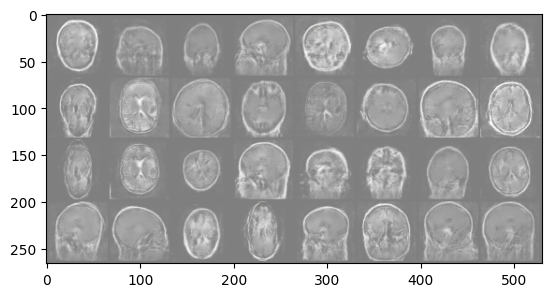

Epoch [47/50] Batch 50/55                   Loss D: 0.5043, loss G: 5.6065


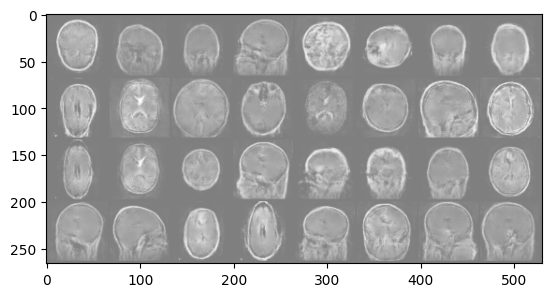

Epoch [48/50] Batch 0/55                   Loss D: 0.3011, loss G: 3.1132


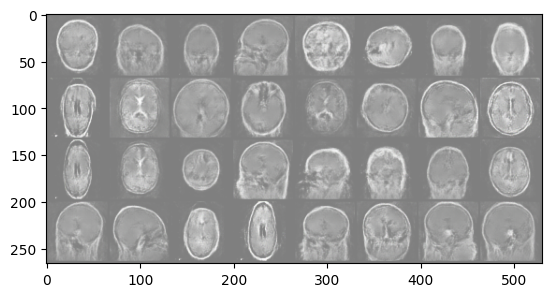

Epoch [48/50] Batch 50/55                   Loss D: 0.1814, loss G: 2.8778


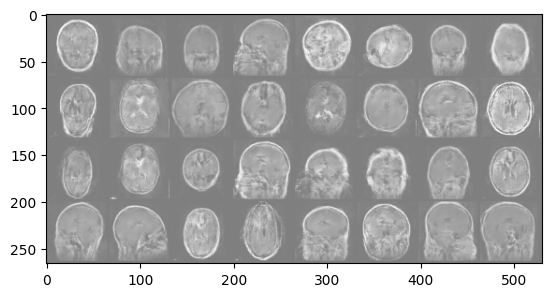

Epoch [49/50] Batch 0/55                   Loss D: 0.4232, loss G: 0.7471


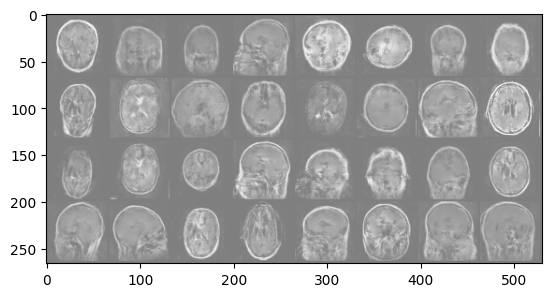

Epoch [49/50] Batch 50/55                   Loss D: 0.2939, loss G: 4.4368


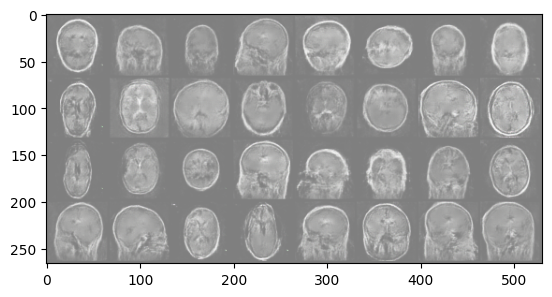

In [26]:
gen.train()
disc.train()

for epoch in range(NUM_EPOCHS):
    for batch_idx, (real, _ ) in enumerate(dataloader):
        real = real.to(device)
        ### create noise tensor
        noise = torch.randn((BATCH_SIZE, Z_DIM, 1, 1)).to(device)
        fake = gen(noise)

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        disc_real = disc(real).reshape(-1)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake.detach()).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        ### Print losses occasionally and fake images occasionally
        if batch_idx % 50 == 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
            )
            with torch.no_grad():
                fake = gen(fixed_noise)
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)
                show_tensor_images(img_grid_fake)

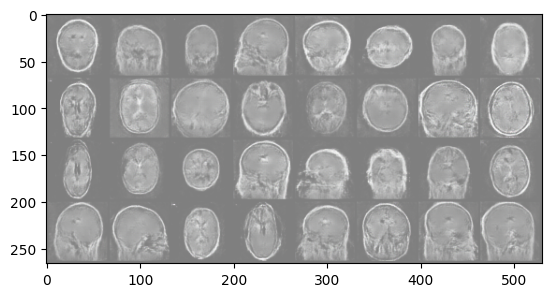

In [28]:
# prompt: plot a new generated images

import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Assuming 'fake' is the tensor of generated images from the last batch
# of the training loop, and 'fixed_noise' is a tensor of fixed noise.

with torch.no_grad():
    fake = gen(fixed_noise)  # Generate images using the fixed noise
    img_grid_fake = vutils.make_grid(fake[:32], normalize=True)
    show_tensor_images(img_grid_fake)

In [32]:
# prompt: calculate the PSNR

import math

def psnr(img1, img2):
    mse = torch.mean((img1 - img2) ** 2)
    if mse == 0:
        return 100
    PIXEL_MAX = 1.0
    return 20 * math.log10(PIXEL_MAX / math.sqrt(mse))

# Example usage (assuming 'real' and 'fake' are tensors of images):
with torch.no_grad():
    fake = gen(fixed_noise)
    # Assuming 'real' is a batch of real images from your dataloader
    # You need to make sure 'real' and 'fake' have the same shape and are on the same device
    # Convert 'real' to a PyTorch tensor and move it to the device
    real_sample = torch.tensor(real[0:fake.shape[0]], device=device, dtype=fake.dtype)

    psnr_value = psnr(real_sample, fake)
    print(f"PSNR: {psnr_value}")

PSNR: 8.045275791922538


In [34]:
# prompt: CALCULATE THE SSIM

from skimage.metrics import structural_similarity as ssim
import numpy as np

# Assuming 'fake' is the tensor of generated images and 'real' is the tensor of real images
with torch.no_grad():
    fake = gen(fixed_noise)
    real_sample = torch.tensor(real[0:fake.shape[0]], device=device, dtype=fake.dtype)

    # Move tensors to CPU and convert to NumPy arrays
    fake_np = fake.cpu().numpy()
    real_np = real_sample.cpu().numpy()

    # Calculate SSIM for each image in the batch
    ssim_values = []
    for i in range(fake.shape[0]):
        # Reshape to (height, width, channels)
        fake_img = np.transpose(fake_np[i], (1, 2, 0))
        real_img = np.transpose(real_np[i], (1, 2, 0))

        # Ensure images are in the range [0, 1]
        fake_img = (fake_img + 1) / 2
        real_img = (real_img + 1) / 2

        # Calculate SSIM, explicitly setting win_size
        ssim_value = ssim(real_img, fake_img, multichannel=True, data_range=1, win_size=3)  # win_size=3 for smaller images
        ssim_values.append(ssim_value)

    # Calculate average SSIM across the batch
    avg_ssim = np.mean(ssim_values)
    print(f"Average SSIM: {avg_ssim}")

Average SSIM: 0.27133455287222696


In [35]:
# prompt: Download the model as h5 and pkl

import torch

# Save the generator model as an h5 file
torch.save(gen.state_dict(), 'generator_model.h5')

# Save the generator model as a pkl file
import pickle
with open('generator_model.pkl', 'wb') as f:
    pickle.dump(gen, f)

# Download the saved model files
from google.colab import files
files.download('generator_model.h5')
files.download('generator_model.pkl')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# prompt: generate new 50 images and load it into new file its name is new

# Generate 50 new images
with torch.no_grad():
    noise = torch.randn(50, Z_DIM, 1, 1).to(device)
    new_images = gen(noise)

# Save the generated images to a new file named 'new'
torchvision.utils.save_image(new_images, 'new.png', normalize=True)